<a href="https://colab.research.google.com/github/duchaba/Data-Augmentation-with-Python/blob/main/data_augmentation_with_python_chapter_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Augmentation with Python, Chapter 3

# 🌻 Welcome to Chapter 3, "Image Augmentation for Classification"


In this chapter, we’ll cover the following topics: 

- Geometric transformations 

- Photometric transformations 

- Random  erasing 

- Combining augmentation techniques 

- Reinforce learning through Python code 

## Set up: Bring back Pluto

### ✋ STOP: Pull Method

- There are two methods to bring back Pluto.

1. Clone from GitHut (or update by doing "git pull if you have clone it before)

2. Or retrieve from an URL. The URL can be the GitHub URL or an URL the you store your Pluto python file from the first lesson.

- Do one, but not both.



### GitHub Clone

In [1]:
# git version should be 2.17.1 or higher
!git --version

git version 2.17.1


In [2]:
#url = 'https://github.com/PacktPublishing/Data-Augmentation-with-Python'
url = 'https://github.com/duchaba/Data-Augmentation-with-Python'
!git clone {url}

Cloning into 'Data-Augmentation-with-Python'...
remote: Enumerating objects: 115, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 115 (delta 13), reused 15 (delta 5), pack-reused 75
Receiving objects: 100% (115/115), 55.34 MiB | 11.44 MiB/s, done.
Resolving deltas: 100% (38/38), done.


### Fetch file from URL (Optional)

- Uncommend the below 2 code cells if you want to use URL and not Git Clone

In [3]:
# import requests
# #
# def fetch_file(url, dst):
#   downloaded_obj = requests.get(url)
#   with open(dst, "wb") as file:
#     file.write(downloaded_obj.content)
#   return

In [4]:
# url = ''
# dst = 'pluto_chapter_1.py'
# fetch_file(url,dst)

### Pluto

- Instantiate up Pluto, aka. "Pluto, wake up!"

In [5]:
#load and run the pluto chapter 1 Python code.
pluto_file = 'Data-Augmentation-with-Python/pluto/pluto_chapter_2.py'
%run {pluto_file}

---------------------------- : ----------------------------
            Hello from class : <class '__main__.PacktDataAug'> Class: PacktDataAug
                   Code name : Pluto
                   Author is : Duc Haba
---------------------------- : ----------------------------


- Double check on the server environments

In [6]:
pluto.say_sys_info()

---------------------------- : ----------------------------
                 System time : 2022/10/08 04:55
                    Platform : linux
       Python version (3.7+) : 3.7.14 (default, Sep  8 2022, 00:06:44) 
[GCC 7.5.0]
     PyTorch version (1.11+) : 1.12.1+cu113
     Pandas version (1.3.5+) : 1.3.5
        PIL version (9.0.0+) : 7.1.2
 Matplotlib version (3.2.2+) : 3.2.2
                   CPU count : 2
                  *CPU speed : NOT available
---------------------------- : ----------------------------


In [7]:
# !cat {pluto_file}

### ✋ STOP: Reinitalize Kaggle

- Install the following libraries, and import it on the Notebook.
- Follow by initialize Kaggle username, key and fetch methods.
- STOP: Update your Kaggle access username or key first.

In [8]:
# -------------------- : --------------------
# READ ME
# Chapter 2 begin:
# Install the following libraries, and import it on the Notebook.
# Follow by initialize Kaggle username, key and fetch methods.
# STOP: Update your Kaggle access username or key first.
# -------------------- : --------------------

!pip install opendatasets --upgrade
import opendatasets
print("\nrequired version 0.1.22 or higher: ", opendatasets.__version__)

!pip install pyspellchecker 
import spellchecker
print("\nRequired version 0.7+", spellchecker.__version__)

# STOP: Update your Kaggle access username or key first.
pluto.remember_kaggle_access_keys("duchaba", "0c737c90feacb5c56232b0d7c24e8664")
pluto._write_kaggle_credit()
import kaggle

@add_method(PacktDataAug)
def fetch_kaggle_comp_data(self,cname):
  #self._write_kaggle_credit()  # need to run only once.
  path = pathlib.Path(cname)
  kaggle.api.competition_download_cli(str(path))
  zipfile.ZipFile(f'{path}.zip').extractall(path)
  return

@add_method(PacktDataAug)
def fetch_kaggle_dataset(self,url,dest="kaggle"):
  #self._write_kaggle_credit()    # need to run only once.
  opendatasets.download(url,data_dir=dest)
  return
# -------------------- : --------------------


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

required version 0.1.22 or higher:  0.1.22
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.5 MB 30.4 MB/s 

Required version 0.7+ 0.7.0


# Fetch Kaggle Data

## Fetch and display Sea Animals

In [9]:
url = 'https://www.kaggle.com/datasets/vencerlanz09/sea-animals-image-dataste'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 266M/266M [00:07<00:00, 39.6MB/s]


In [10]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/sea-animals-image-dataste'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [11]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/sea-animals-image-dataste'
#!find {f} -name "* *" -type d | rename 's/ /_/g'
!find {f} -name "* *" -type f | rename 's/ /_/g'

In [12]:
# change method name to make_dir_dframe
pluto.df_sea_animal = pluto.build_shoe_fname(f)
pluto.df_sea_animal.head(3)

,fname,label
0,kaggle/sea-animals-image-dataste/Turtle_Tortoi...,Turtle_Tortoise
1,kaggle/sea-animals-image-dataste/Turtle_Tortoi...,Turtle_Tortoise
2,kaggle/sea-animals-image-dataste/Turtle_Tortoi...,Turtle_Tortoise


In [13]:
# pluto.make_dir_dframe = lambda f: pluto.build_shoe_fname(f)
# df3 = pluto.make_dir_dframe('kaggle/sea-animals-image-dataste')
# df3.head()

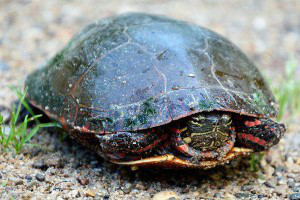

In [14]:
img = PIL.Image.open(pluto.df_sea_animal.fname[0])
display(img)

## covid 19

In [15]:
url = 'https://www.kaggle.com/datasets/pranavraikokte/covid19-image-dataset'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 158M/158M [00:03<00:00, 53.5MB/s]


In [16]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/covid19-image-dataset/Covid19-dataset/train'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [17]:
pluto.df_covid19 = pluto.build_shoe_fname(f)
pluto.df_covid19.head(3)


,fname,label
0,kaggle/covid19-image-dataset/Covid19-dataset/t...,Normal
1,kaggle/covid19-image-dataset/Covid19-dataset/t...,Normal
2,kaggle/covid19-image-dataset/Covid19-dataset/t...,Normal


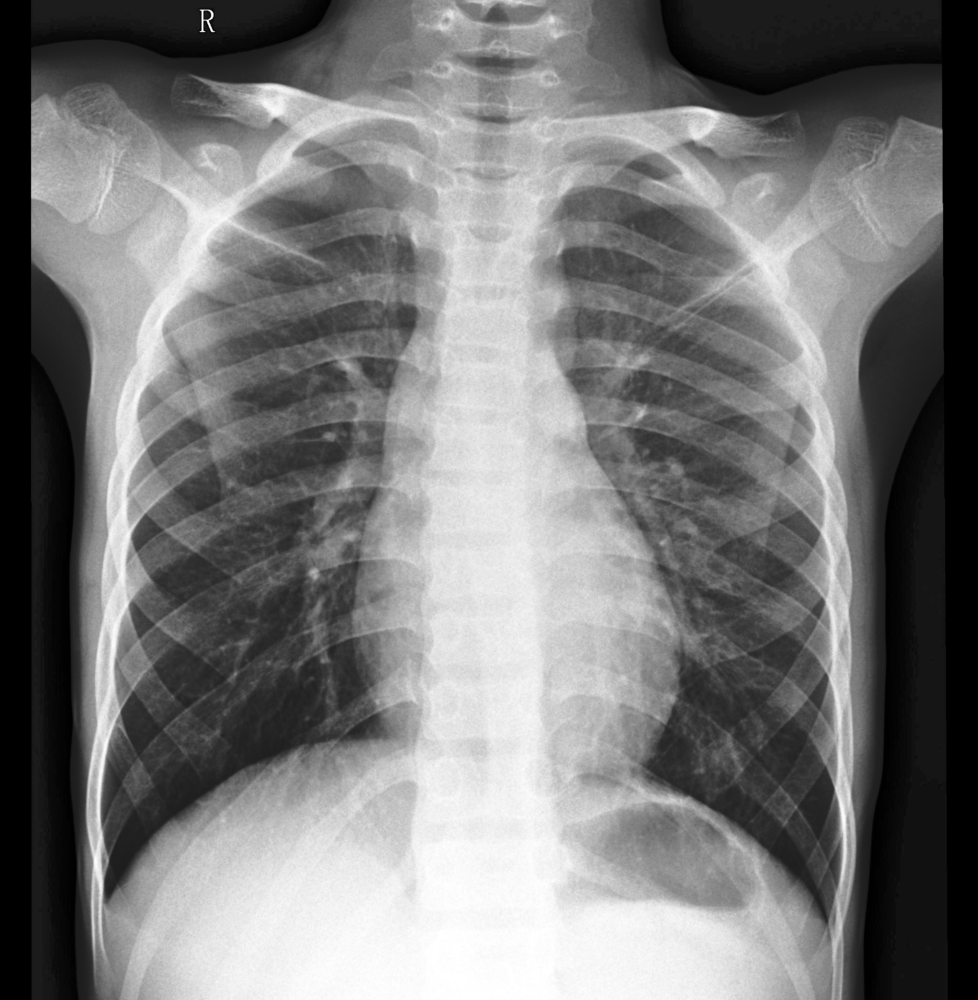

In [18]:
img = PIL.Image.open(pluto.df_covid19.fname[0])
display(img)

## Mall Crowd

In [19]:
url = 'https://www.kaggle.com/datasets/ferasoughali/mall-crowd-estimation'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 87.6M/87.6M [00:03<00:00, 28.6MB/s]


In [20]:
f = 'kaggle/mall-crowd-estimation/mall_dataset/frames/Thumbs.db'
!rm {f}

In [21]:
f = 'kaggle/mall-crowd-estimation/mall_dataset/frames'
pluto.df_crowd = pluto.build_shoe_fname(f)
pluto.df_crowd.head(3)

,fname,label
0,kaggle/mall-crowd-estimation/mall_dataset/fram...,frames
1,kaggle/mall-crowd-estimation/mall_dataset/fram...,frames
2,kaggle/mall-crowd-estimation/mall_dataset/fram...,frames


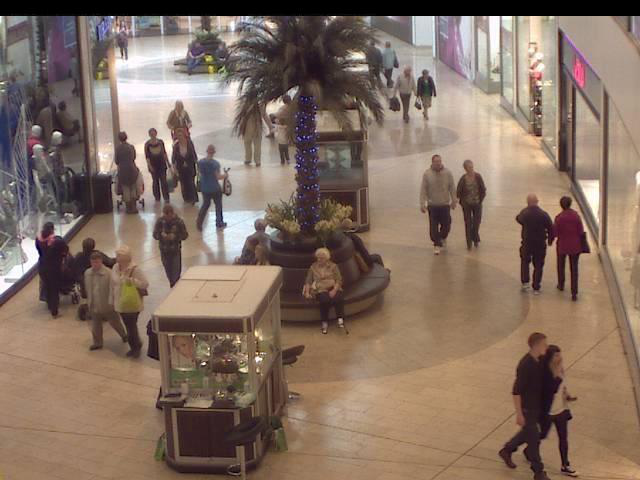

In [22]:
img = PIL.Image.open(pluto.df_crowd.fname[0])
display(img)

## Indian pictures

In [23]:
url = 'https://www.kaggle.com/datasets/sinhayush29/indian-people'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 228M/228M [00:07<00:00, 31.0MB/s]


In [24]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/indian-people'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [25]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/indian-people/Indian_Train_Set'
#!find {f} -name "* *" -type d | rename 's/ /_/g'
!find {f} -name "* *" -type f | rename 's/ /_/g'

In [26]:
f = 'kaggle/indian-people/Indian_Train_Set/Indian'
pluto.df_people = pluto.build_shoe_fname(f)
pluto.df_people.head(3)

,fname,label
0,kaggle/indian-people/Indian_Train_Set/Indian/T...,Indian
1,kaggle/indian-people/Indian_Train_Set/Indian/T...,Indian
2,kaggle/indian-people/Indian_Train_Set/Indian/T...,Indian


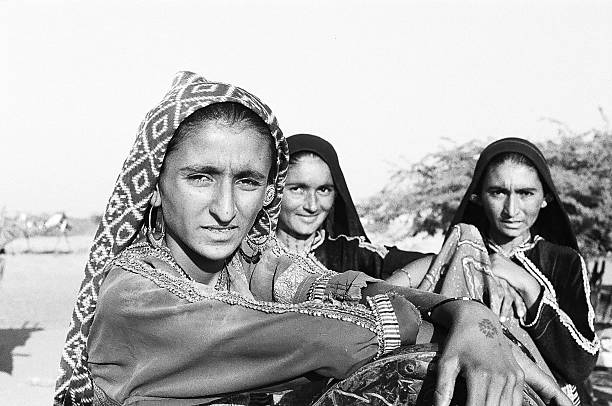

In [27]:
img = PIL.Image.open(pluto.df_people.fname[0])
display(img)

## Vietnamese food

In [28]:
url = 'https://www.kaggle.com/datasets/quandang/vietnamese-foods'
pluto.fetch_kaggle_dataset(url)
# use word assemble

100%|██████████| 4.17G/4.17G [01:43<00:00, 43.2MB/s]


In [29]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/vietnamese-foods/Images/Train'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [30]:
f = 'kaggle/vietnamese-foods/Images/Train'
pluto.df_food = pluto.build_shoe_fname(f)
pluto.df_food.head(3)

,fname,label
0,kaggle/vietnamese-foods/Images/Train/Mi_quang/...,Mi_quang
1,kaggle/vietnamese-foods/Images/Train/Mi_quang/...,Mi_quang
2,kaggle/vietnamese-foods/Images/Train/Mi_quang/...,Mi_quang


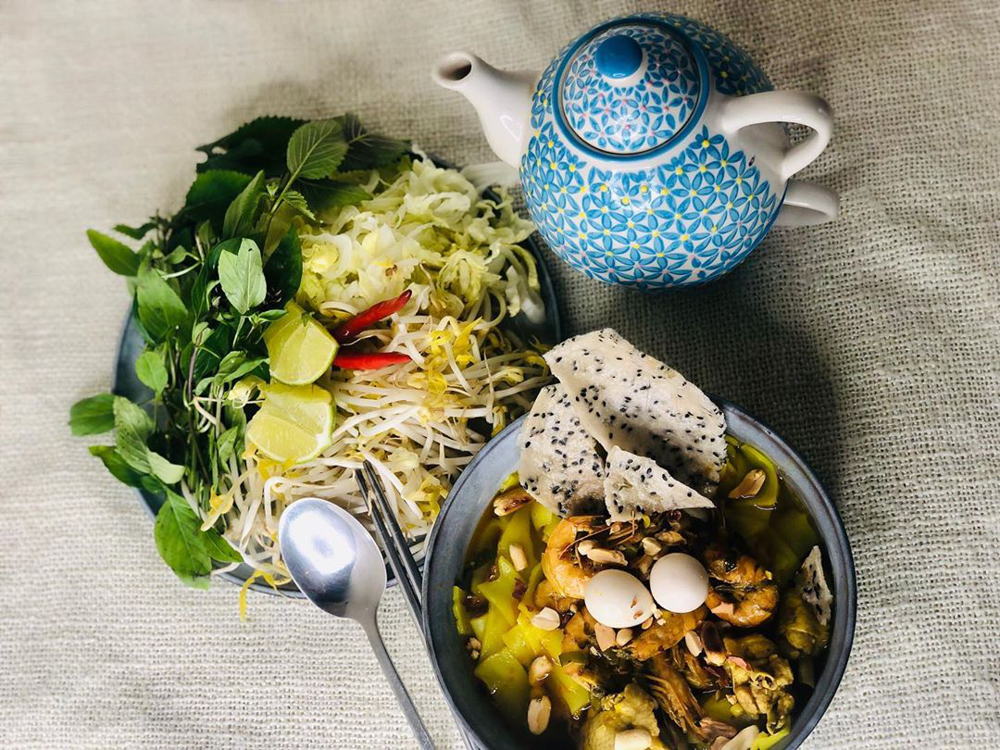

In [31]:
img = PIL.Image.open(pluto.df_food.fname[0])
display(img)

## Fungi

In [32]:
url = 'https://www.kaggle.com/datasets/marcosvolpato/edible-and-poisonous-fungi'
pluto.fetch_kaggle_dataset(url)
# use word assemble

100%|██████████| 257M/257M [00:09<00:00, 27.1MB/s]

In [33]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/edible-and-poisonous-fungi'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [34]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/edible-and-poisonous-fungi'
# !find {f} -name "* *" -type d | rename 's/ /_/g'
!find {f} -name "* *" -type f | rename 's/ /_/g'

In [35]:
pluto.df_fungi = pluto.build_shoe_fname(f)
pluto.df_fungi.head(3)

,fname,label
0,kaggle/edible-and-poisonous-fungi/poisonous_sp...,poisonous_sporocarp
1,kaggle/edible-and-poisonous-fungi/poisonous_sp...,poisonous_sporocarp
2,kaggle/edible-and-poisonous-fungi/poisonous_sp...,poisonous_sporocarp


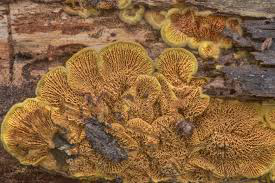

In [36]:
img = PIL.Image.open(pluto.df_fungi.fname[0])
display(img)

# Draw the Images

## display patch

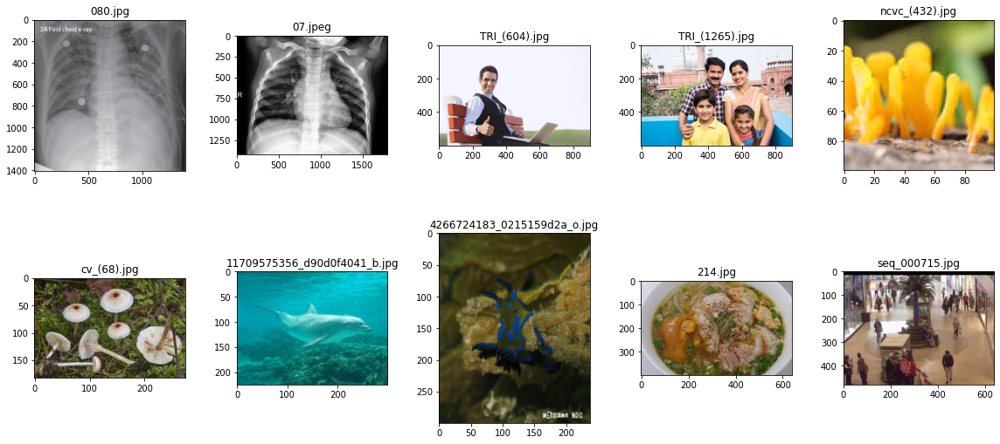

In [37]:
df = [pluto.df_covid19.sample(2), pluto.df_people.sample(2),
  pluto.df_fungi.sample(2), pluto.df_sea_animal.sample(2),
  pluto.df_food.sample(1), pluto.df_crowd.sample(1)]

df_samp = pandas.concat(df)
x = pluto.draw_batch(df_samp.fname)

# Geometric transformations filters 

In [38]:
!pip install -Uqq fastai
from fastcore.all import *
import fastai
import fastai.vision
import fastai.vision.core
import fastai.vision.augment
import numpy
print("\nfastai version (should be 2.6.3 or higher): ", fastai.__version__)


fastai version (should be 2.6.3 or higher):  2.7.9


## Horizontal flip

In [39]:
import PIL
import PIL.ImageOps
@add_method(PacktDataAug)
def draw_image_flip_pil(self,fname):
  img = PIL.Image.open(fname)
  mirror_img = PIL.ImageOps.mirror(img)
  display(img, mirror_img)
  return

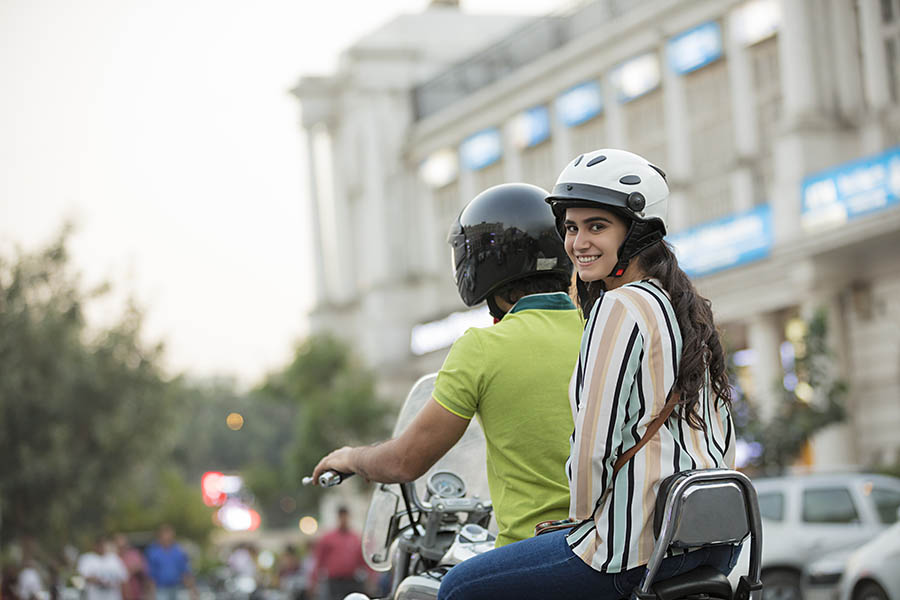

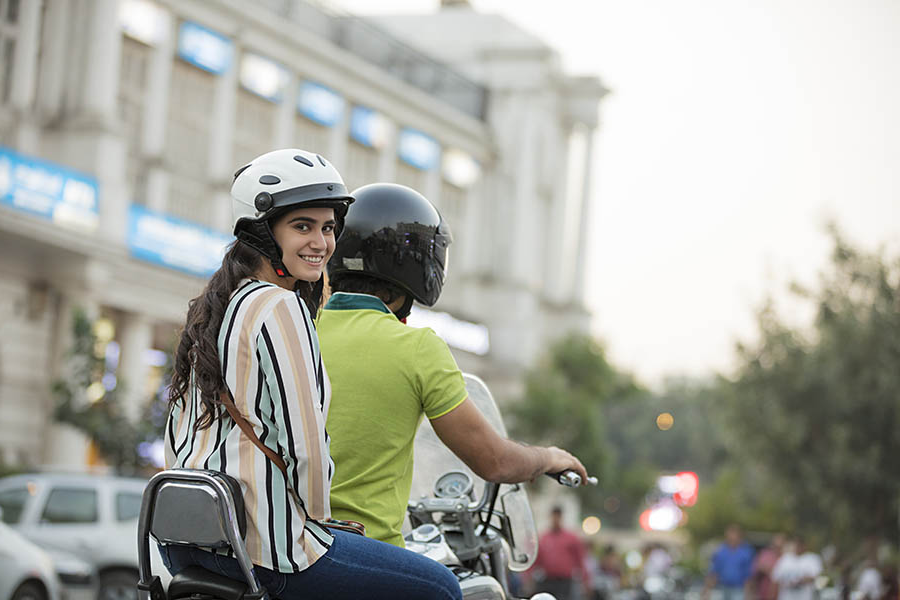

In [40]:
pluto.draw_image_flip_pil(pluto.df_people.fname[100])

In [41]:
# import fastai.vision.augment.CropPad??

In [42]:
@add_method(PacktDataAug)
def _make_data_loader(self,df, tfms, i_tfms=None):
  dls = fastai.vision.data.ImageDataLoaders.from_df(df, 
  fn_col="fname",label_col="label",
  item_tfms=i_tfms,
  batch_tfms=tfms,
  valid_pct=0.2,
  bs=32)
  return dls
#
# fastai.vision.augment.RandomCrop
# fastai.vision.augment.CropPad(480)
# import fastai.vision.augment. (to see all other option like flip, hue, etc)
@add_method(PacktDataAug)
def draw_image_flip(self,df,bsize=15):
  tfms_flip = fastai.vision.augment.aug_transforms(
    mult = 1.0,            # Multiplication applying to max_rotate,max_lighting,max_warp
    do_flip = True,           
    flip_vert = False, 
    max_rotate = 1.0, 
    min_zoom = 1.0, 
    max_zoom = 1.0, 
    max_lighting = 0.0, 
    max_warp = 0.0, 
    p_affine = 0.75,         # Probability of applying affine transformation
    p_lighting = 0.0,       # Probability of changing brightnest and contrast
    xtra_tfms = None,       # Custom Transformations
    size = None,            # Crop to size, e.g. 200 = (square 200x200)
    mode = 'bilinear',      # PyTorch F.grid_sample interpolation
    pad_mode='zeros',       # zeros, border, reflection
    align_corners=True,     # PyTorch F.grid_sample align_corners
    batch=False,            # Apply identical transformation to entire batch
    min_scale=1.0)          # Minimum scale of the crop, in relation to image area
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, tfms_flip,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

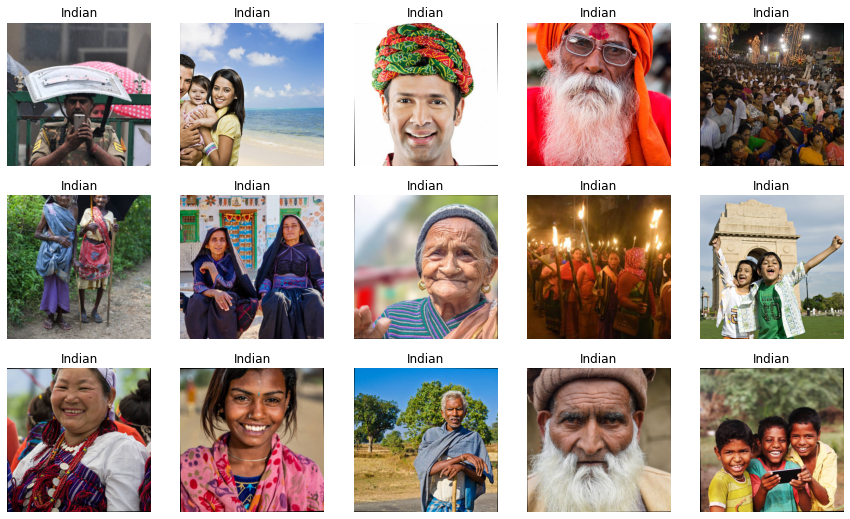

In [43]:
pluto.dls_people = pluto.draw_image_flip(pluto.df_people)

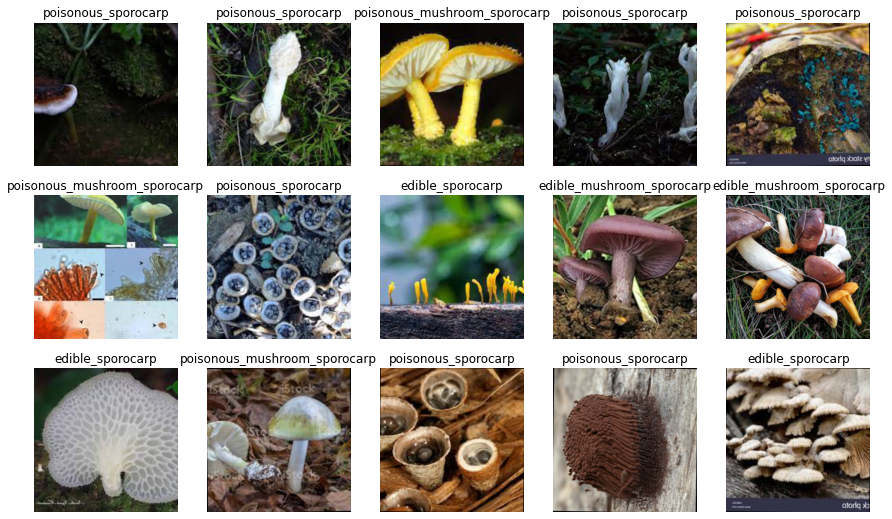

In [44]:
pluto.dls_fungi = pluto.draw_image_flip(pluto.df_fungi)

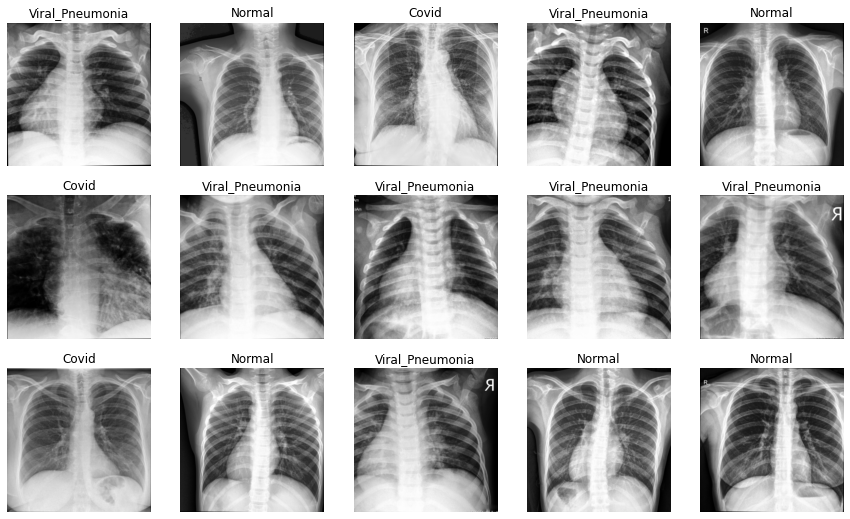

In [45]:
pluto.dls_covid19 = pluto.draw_image_flip(pluto.df_covid19)

In [46]:
@add_method(PacktDataAug)
def draw_image_flip_both(self,df,bsize=15):
  tfms_flip = fastai.vision.augment.aug_transforms(
    mult = 1.0,            # Multiplication applying to max_rotate,max_lighting,max_warp
    do_flip = True,           
    flip_vert = True, 
    max_rotate = 1.0, 
    min_zoom = 1.0, 
    max_zoom = 1.0, 
    max_lighting = 0.0, 
    max_warp = 0.0, 
    p_affine = 0.75,         # Probability of applying affine transformation
    p_lighting = 0.0,       # Probability of changing brightnest and contrast
    xtra_tfms = None,       # Custom Transformations
    size = None,            # Crop to size, e.g. 200 = (square 200x200)
    mode = 'bilinear',      # PyTorch F.grid_sample interpolation
    pad_mode='zeros',       # zeros, border, reflection
    align_corners=True,     # PyTorch F.grid_sample align_corners
    batch=False,            # Apply identical transformation to entire batch
    min_scale=1.0)          # Minimum scale of the crop, in relation to image area
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, tfms_flip,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

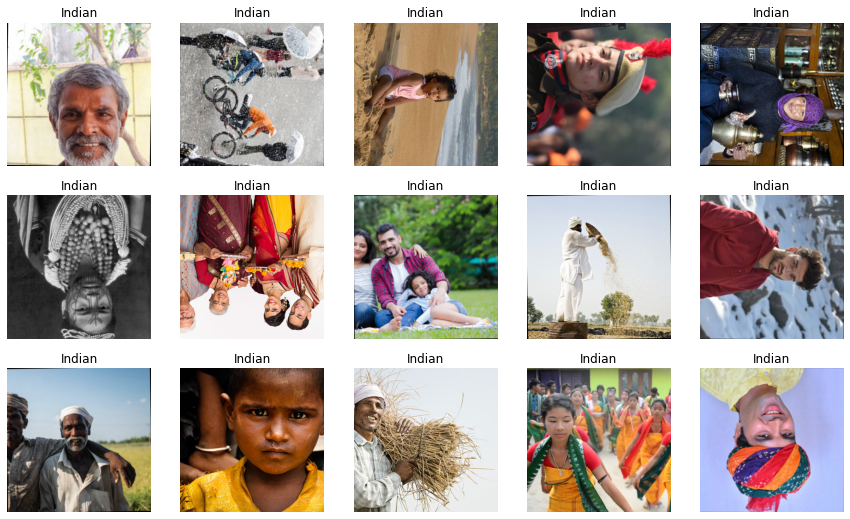

In [47]:
pluto.dls_people = pluto.draw_image_flip_both(pluto.df_people)

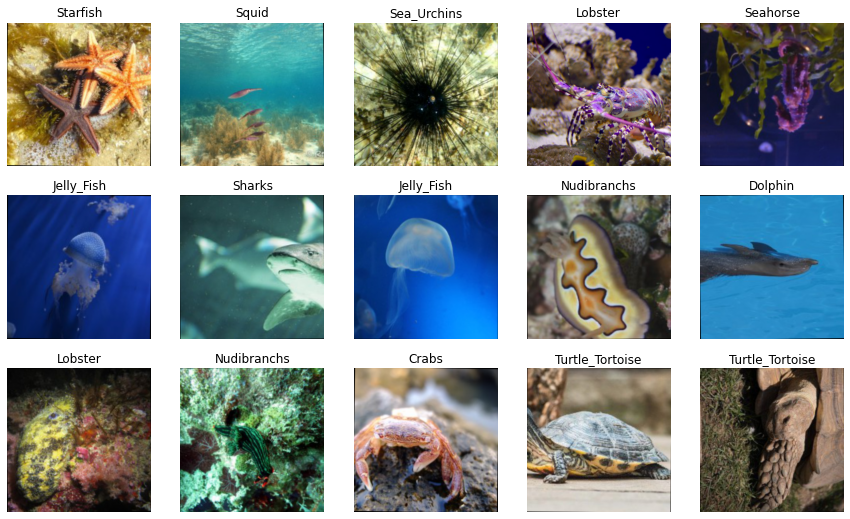

In [48]:
pluto.dls_sea_animal = pluto.draw_image_flip_both(pluto.df_sea_animal)

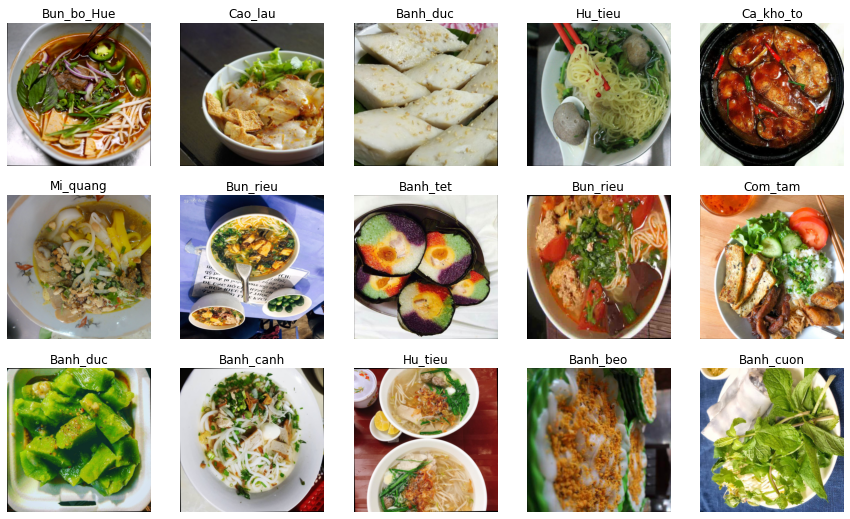

In [49]:
pluto.dls_food = pluto.draw_image_flip_both(pluto.df_food)

## Croping and Padding

In [50]:
@add_method(PacktDataAug)
def draw_image_crop(self,df,bsize=15,pad_mode="zeros",isize=480):
  tfms = fastai.vision.augment.aug_transforms(
    mult = 1.0,            # Multiplication applying to max_rotate,max_lighting,max_warp
    do_flip = False,           
    flip_vert = False, 
    max_rotate = 1.0, 
    min_zoom = 1.0, 
    max_zoom = 1.0, 
    max_lighting = 0.0, 
    max_warp = 0.0, 
    p_affine = 0.75,         # Probability of applying affine transformation
    p_lighting = 0.0,       # Probability of changing brightnest and contrast
    xtra_tfms = None,       # Custom Transformations
    size = None,            # Crop to size, e.g. 200 = (square 200x200)
    mode = 'bilinear',      # PyTorch F.grid_sample interpolation
    pad_mode='zeros',       # zeros, border, reflection
    align_corners=True,     # PyTorch F.grid_sample align_corners
    batch=False,            # Apply identical transformation to entire batch
    min_scale=1.0)          # Minimum scale of the crop, in relation to image area
  itfms = fastai.vision.augment.CropPad(isize, pad_mode=pad_mode)
  dsl_org = self._make_data_loader(df, tfms,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

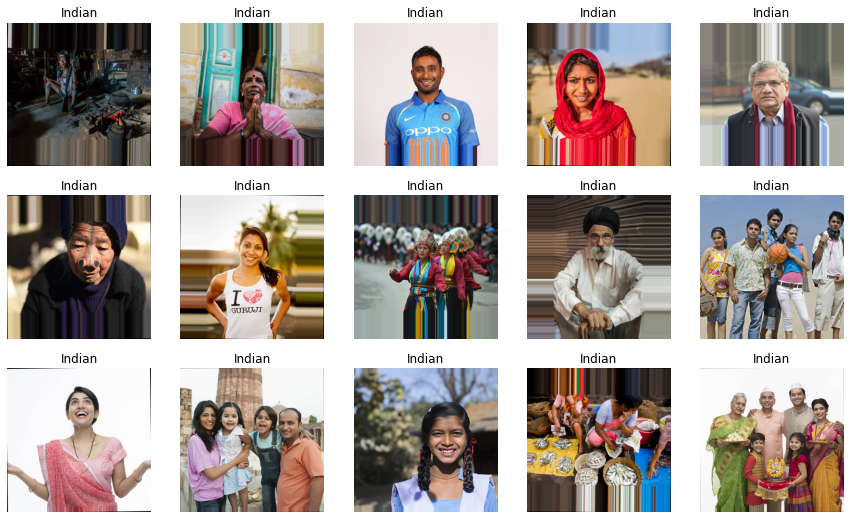

In [51]:
pluto.dls_people = pluto.draw_image_crop(pluto.df_people, pad_mode="border",isize=640)

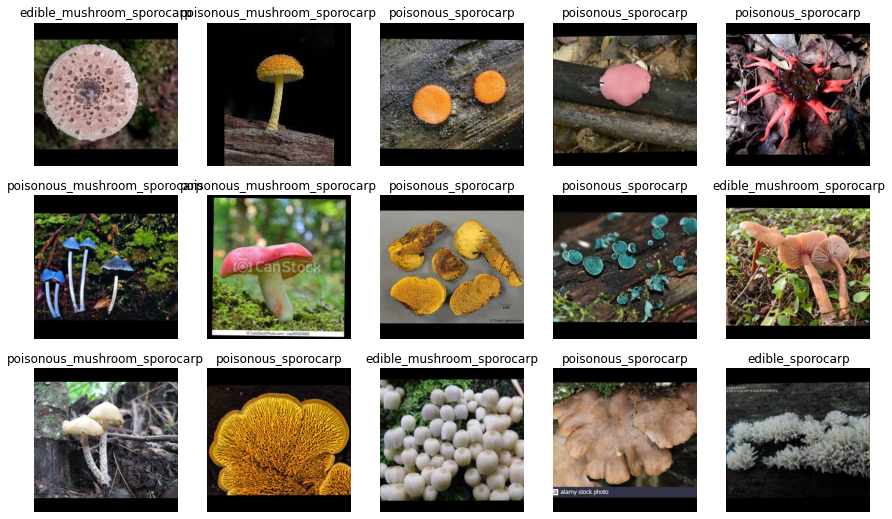

In [52]:
pluto.dls_fungi = pluto.draw_image_crop(pluto.df_fungi,pad_mode="zeros",isize=240)

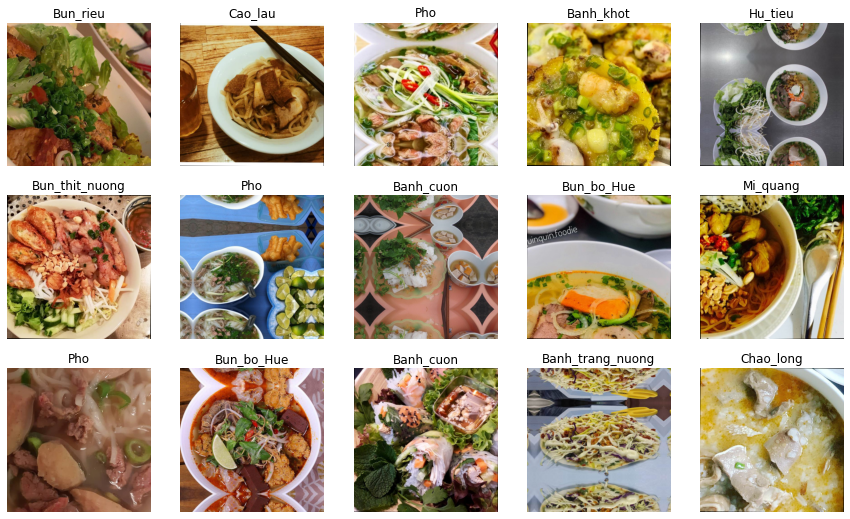

In [53]:
pluto.dls_food = pluto.draw_image_crop(pluto.df_food,pad_mode="reflection",isize=640)

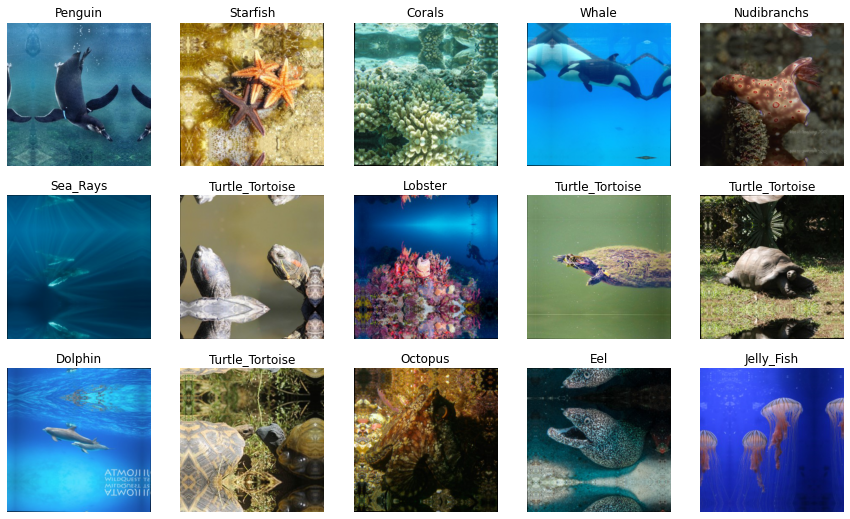

In [54]:
pluto.dls_sea_animal = pluto.draw_image_crop(pluto.df_sea_animal,pad_mode="reflection", isize=340)

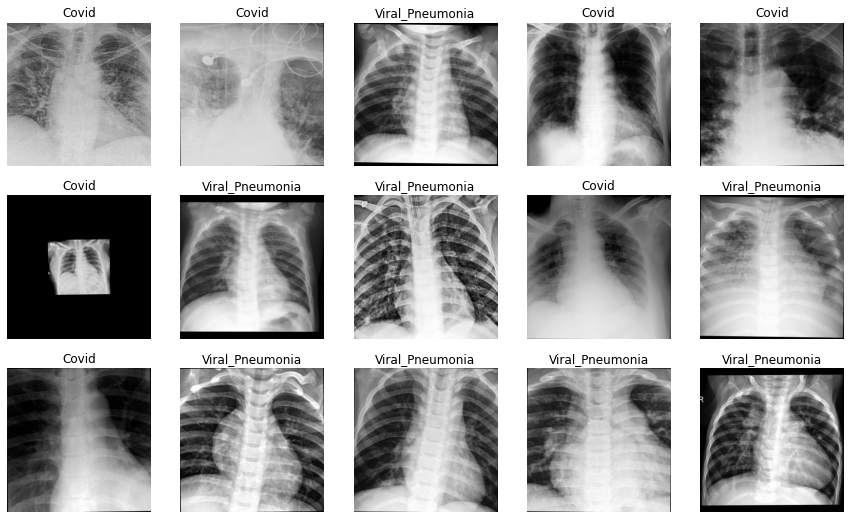

In [55]:
pluto.dls_covid19 = pluto.draw_image_crop(pluto.df_covid19,pad_mode="zeros", isize=1024)

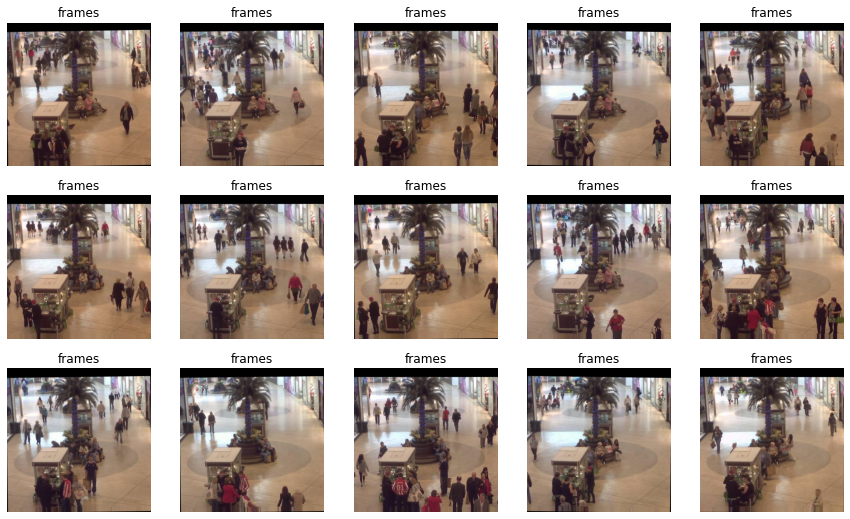

In [56]:
pluto.dls_crowd = pluto.draw_image_crop(pluto.df_crowd,pad_mode="border", isize=512)

## Rotation

In [57]:
@add_method(PacktDataAug)
def draw_image_rotate(self,df,bsize=15,max_rotate = 1.5, pad_mode='zeros'):
  tfms = fastai.vision.augment.aug_transforms(
    mult = 1.2,            # Multiplication applying to max_rotate,max_lighting,max_warp
    do_flip = False,           
    flip_vert = False, 
    max_rotate = max_rotate, 
    min_zoom = 1.0, 
    max_zoom = 1.0, 
    max_lighting = 0.0, 
    max_warp = 0.0, 
    p_affine = 0.75,         # Probability of applying affine transformation
    p_lighting = 0.0,       # Probability of changing brightnest and contrast
    xtra_tfms = None,       # Custom Transformations
    size = None,            # Crop to size, e.g. 200 = (square 200x200)
    mode = 'bilinear',      # PyTorch F.grid_sample interpolation
    pad_mode=pad_mode,      # zeros, border, reflection
    align_corners=True,     # PyTorch F.grid_sample align_corners
    batch=False,            # Apply identical transformation to entire batch
    min_scale=1.0)          # Minimum scale of the crop, in relation to image area
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, tfms,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

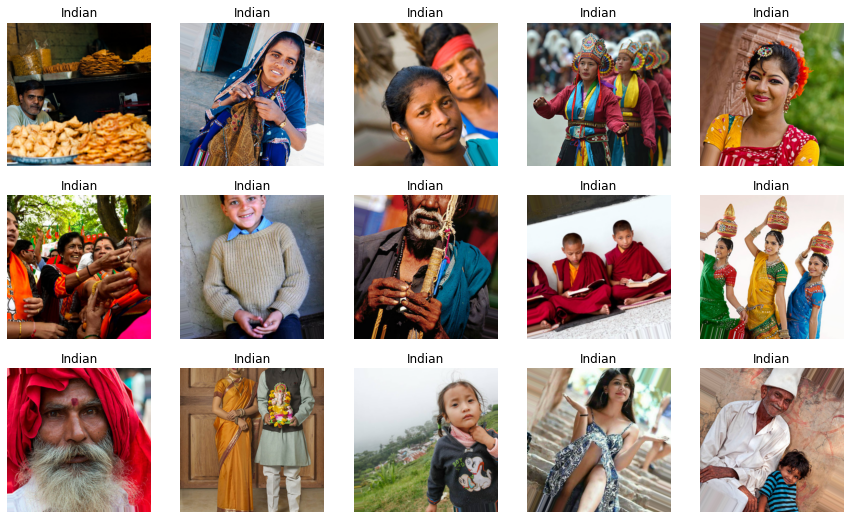

In [58]:
pluto.dls_people = pluto.draw_image_rotate(pluto.df_people,max_rotate=25.0, pad_mode='border')

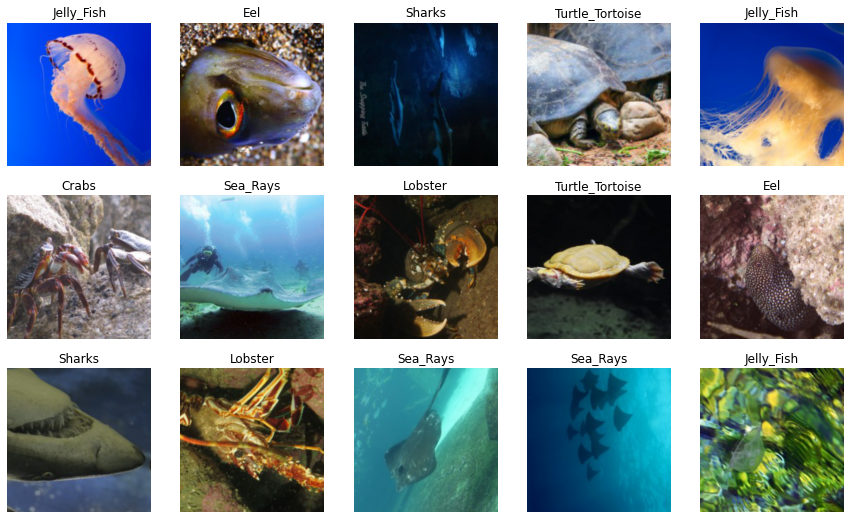

In [59]:
pluto.dls_sea_animal = pluto.draw_image_rotate(pluto.df_sea_animal,max_rotate=180.0, pad_mode='reflection')

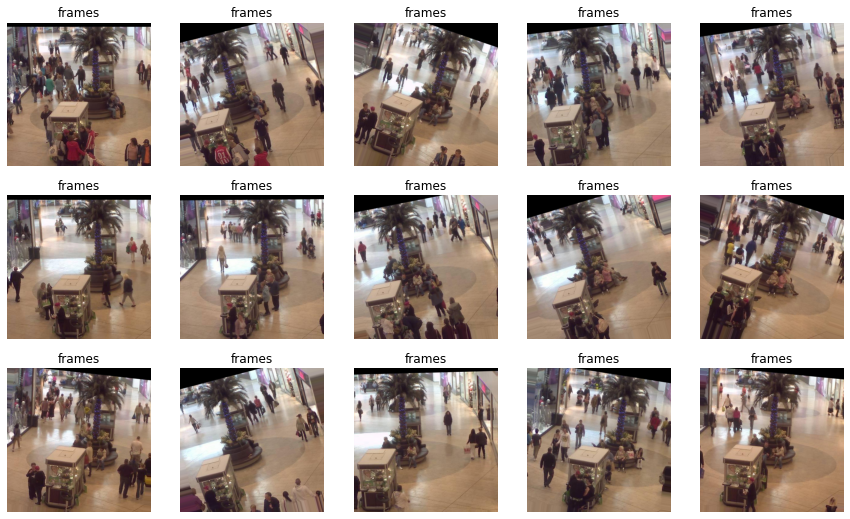

In [60]:
pluto.dls_crowd = pluto.draw_image_rotate(pluto.df_crowd,max_rotate=16.0, pad_mode='border')

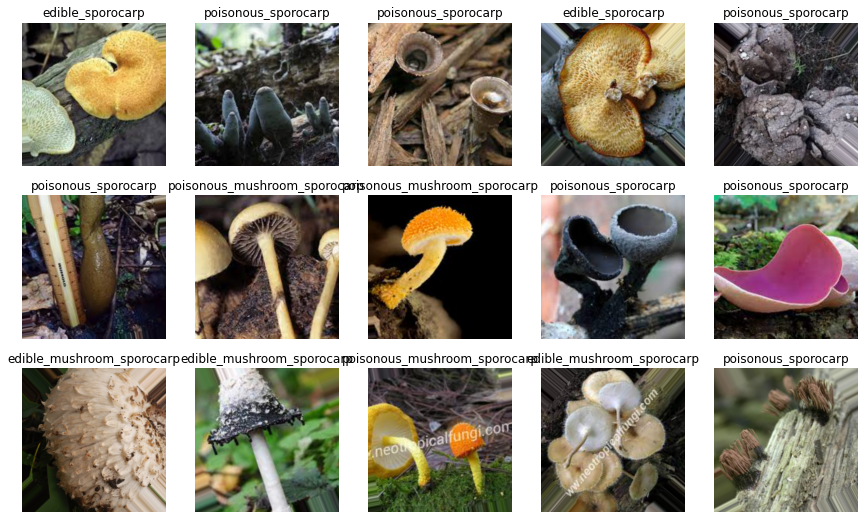

In [61]:
pluto.dls_fungi = pluto.draw_image_rotate(pluto.df_fungi,max_rotate=45.0, pad_mode='border')

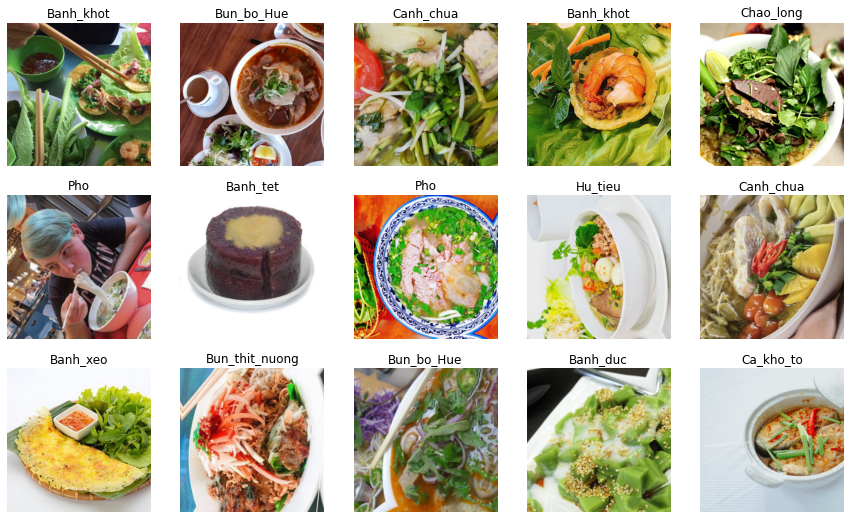

In [62]:
pluto.dls_food = pluto.draw_image_rotate(pluto.df_food,max_rotate=90.0, pad_mode='reflection')

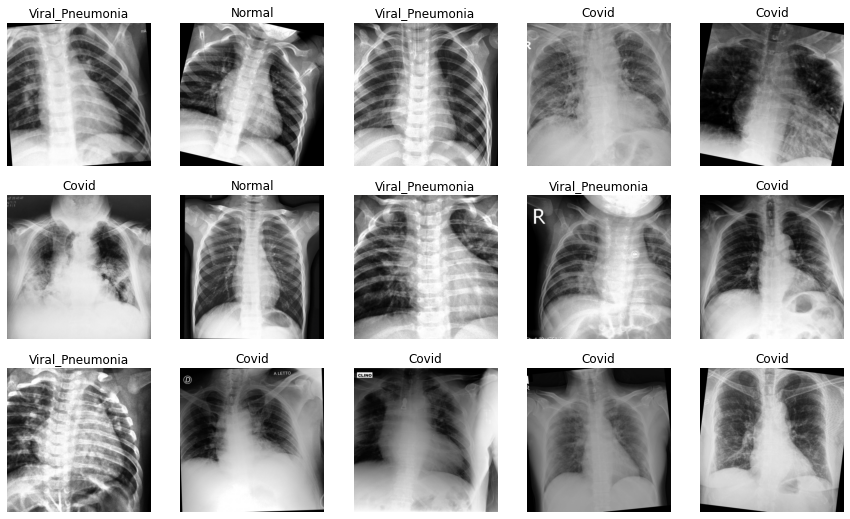

In [63]:
pluto.dls_covid19 = pluto.draw_image_rotate(pluto.df_covid19,max_rotate=12.0, pad_mode='zeros')

In [64]:
#fastai.vision.augment.cutout_gaussian?

## Translation

In [65]:
@add_method(PacktDataAug)
def draw_image_shift_pil(self,fname, x_axis, y_axis=0):
  img = PIL.Image.open(fname)
  shift_img = PIL.ImageChops.offset(img,x_axis,y_axis)
  display(img, shift_img)
  return

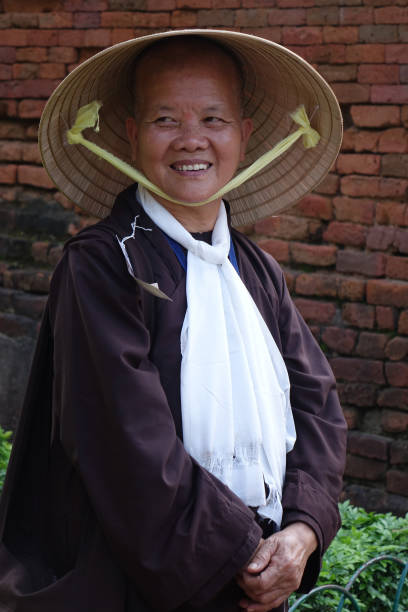

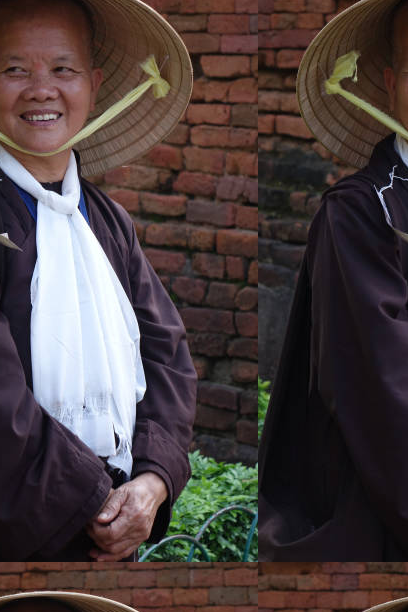

In [66]:
f = pluto.df_people.fname[30]
pluto.draw_image_shift_pil(f, -150, -50)

# Phometric transformations

In [66]:
# import fastai.vision.augment.grayscale?

In [104]:
@add_method(PacktDataAug)
def _draw_image_album(self,df,aug_album,bsize=5):
  ncol = 5
  nrow = int(numpy.ceil(bsize/ncol))
  w = 14
  h = int(4 * nrow)
  canvas, pic = matplotlib.pyplot.subplots(nrow, ncol, figsize=(w, h))
  pics = pic.flatten()
  samp = df.sample(int(ncol * nrow))
  samp.reset_index(drop=True, inplace=True)
  for i, ax in enumerate(pics):
    img_numpy = numpy.array(PIL.Image.open(samp.fname[i]))
    label = df.label[i]
    img = aug_album(image=img_numpy)['image']
    ax.imshow(img)
    ax.set_title(label)
  canvas.tight_layout()
  canvas.show()
  return

## Lighting

In [67]:
@add_method(PacktDataAug)
def draw_image_light(self,df,bsize=15,max_lighting=0.5):
  tfms = fastai.vision.augment.aug_transforms(
    mult = 1.2,            # Multiplication applying to max_rotate,max_lighting,max_warp
    do_flip = False,           
    flip_vert = False, 
    max_rotate = 1.0, 
    min_zoom = 1.0, 
    max_zoom = 1.0, 
    max_lighting = max_lighting, 
    max_warp = 0.0, 
    p_affine = 0.75,         # Probability of applying affine transformation
    p_lighting = 0.75,       # Probability of changing brightnest and contrast
    xtra_tfms = None,       # Custom Transformations
    size = None,            # Crop to size, e.g. 200 = (square 200x200)
    mode = 'bilinear',      # PyTorch F.grid_sample interpolation
    pad_mode='zeros',       # zeros, border, reflection
    align_corners=True,     # PyTorch F.grid_sample align_corners
    batch=False,            # Apply identical transformation to entire batch
    min_scale=1.0)          # Minimum scale of the crop, in relation to image area
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, tfms,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

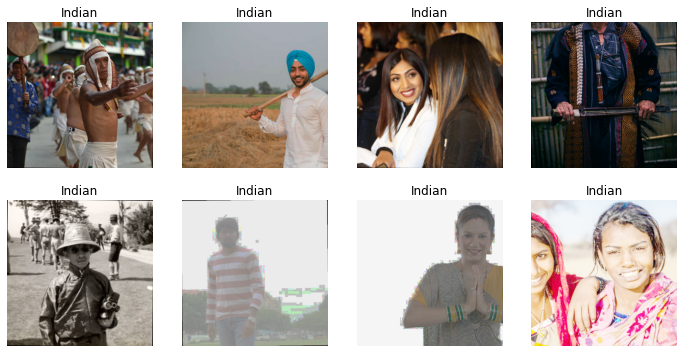

In [68]:
pluto.dls_people = pluto.draw_image_light(pluto.df_people, max_lighting=0.75, bsize=8)

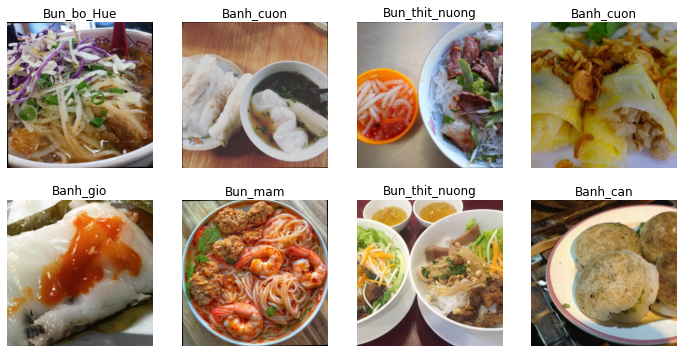

In [69]:
pluto.dls_food = pluto.draw_image_light(pluto.df_food, max_lighting=0.25, bsize=8)

## Grayscale


In [ ]:
@add_method(PacktDataAug)
def draw_image_grayscale(self,df,bsize=15):
  tfms = fastai.vision.augment.aug_transforms(
    mult = 1.2,            # Multiplication applying to max_rotate,max_lighting,max_warp
    do_flip = False,           
    flip_vert = False, 
    max_rotate = 1.0, 
    min_zoom = 1.0, 
    max_zoom = 1.0, 
    max_lighting = 0.0, 
    max_warp = 0.0, 
    p_affine = 0.75,         # Probability of applying affine transformation
    p_lighting = 0.75,       # Probability of changing brightnest and contrast
    xtra_tfms = [fastai.vision.augment.Saturation(max_lighting=0.0, p=1.0)],       # Custom Transformations
    size = 480,             # Crop to size, e.g. 200 = (square 200x200)
    mode = 'bilinear',      # PyTorch F.grid_sample interpolation
    pad_mode='zeros',       # zeros, border, reflection
    align_corners=True,     # PyTorch F.grid_sample align_corners
    batch=False,            # Apply identical transformation to entire batch
    min_scale=1.0)          # Minimum scale of the crop, in relation to image area
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, tfms,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

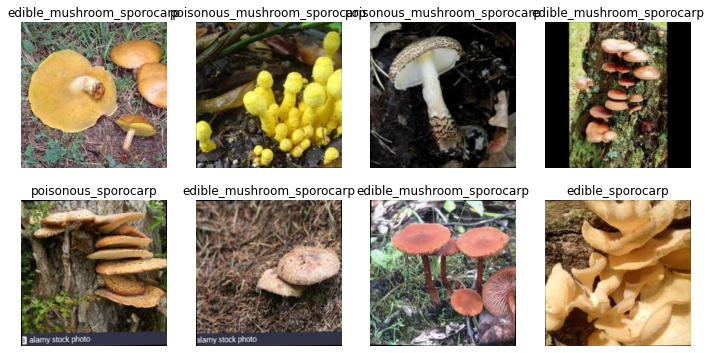

In [ ]:
pluto.dls_fungi = pluto.draw_image_grayscale(pluto.df_fungi, bsize=8)

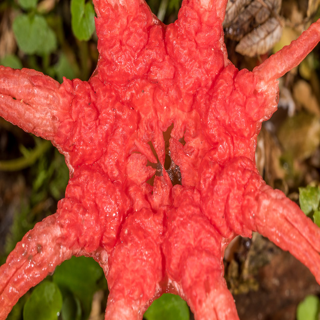

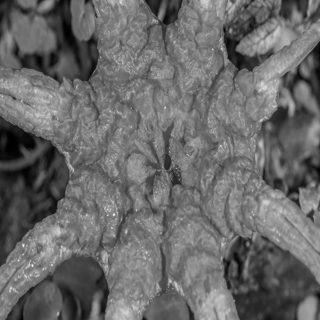

In [110]:
# Importing Image and ImageOps module from PIL package
#from PIL import Image, ImageOps
     
# creating a image1 object
#im1 = PIL.Image.open(pluto.df_food.fname[100])
im1 = fastai.vision.core.PILImage.create(pluto.df_fungi.fname[7]).resize([320,320])
 
# applying grayscale method
im2 = PIL.ImageOps.grayscale(im1)
display(im1,im2)

In [100]:
fastai.vision.core.PILImage.resize?

In [72]:
!pip install albumentations

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [67]:
import albumentations
print(albumentations.__version__)

1.2.1


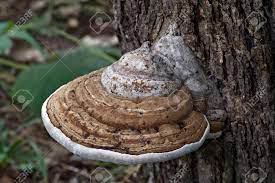

In [68]:
img = fastai.vision.core.PILImage.create(pluto.df_fungi.fname[200])
img

In [69]:
#aug = ShiftScaleRotate(p=1)
aug = albumentations.ToGray(p=1.0)
def aug_tfm(img): 
  np_img = numpy.array(img)
  aug_img = aug(image=np_img)['image']
  return fastai.vision.core.PILImage.create(aug_img)

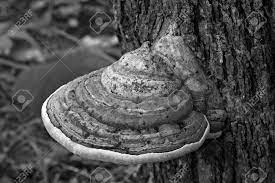

In [83]:
aug_tfm(img)

In [100]:
@add_method(PacktDataAug)
def draw_image_grayscale(self,df,bsize=5):
  aug_album = albumentations.ToGray(p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

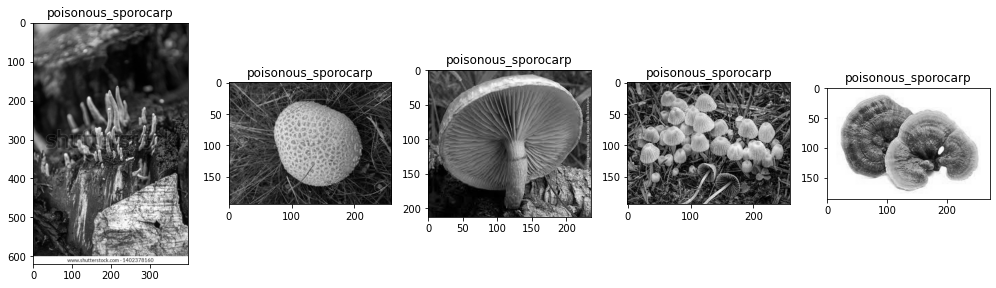

In [105]:
pluto.draw_image_grayscale(pluto.df_fungi)

In [89]:
pluto.df_fungi.sample(5).head()

,fname,label
2193,kaggle/edible-and-poisonous-fungi/poisonous_mushroom_sporocarp/cv_(150).jpg,poisonous_mushroom_sporocarp
684,kaggle/edible-and-poisonous-fungi/poisonous_sporocarp/nncv_(386).jpg,poisonous_sporocarp
2352,kaggle/edible-and-poisonous-fungi/edible_mushroom_sporocarp/ce_(673).jpg,edible_mushroom_sporocarp
2257,kaggle/edible-and-poisonous-fungi/edible_mushroom_sporocarp/ce_(428).jpg,edible_mushroom_sporocarp
299,kaggle/edible-and-poisonous-fungi/poisonous_sporocarp/nncv_(468).jpg,poisonous_sporocarp


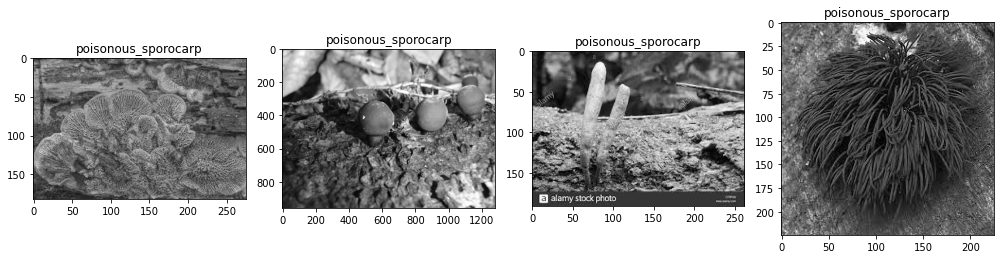

In [77]:
import albumentations as A

#aug = A.Blur(p=1.0)
aug = A.ToGray(p=1.0)

nrow, ncol = 1, 4

fig, axes = matplotlib.pyplot.subplots(nrow, ncol, figsize=(14, 4))
axes = axes.flatten()
for i, ax in enumerate(axes):
    #image, label = train_dataset[i]
    #img = fastai.vision.core.PILImage.create(pluto.df_fungi.fname[i])
    img = PIL.Image.open(pluto.df_fungi.fname[i])
    #PIL.Image.open(fname)
    image = numpy.array(img)
    label = pluto.df_fungi.label[i]
    # I added only this 1 line!
    image = aug(image=image)['image']
    ax.imshow(image)
    ax.set_title(label)
fig.tight_layout()
fig.show()

## scrath fastbook

In [77]:
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()
from fastbook import *

     |████████████████████████████████| 719 kB 31.7 MB/s 
     |████████████████████████████████| 4.9 MB 36.2 MB/s 
     |████████████████████████████████| 432 kB 56.6 MB/s 
     |████████████████████████████████| 1.3 MB 52.1 MB/s 
     |████████████████████████████████| 212 kB 72.0 MB/s 
     |████████████████████████████████| 115 kB 68.8 MB/s 
     |████████████████████████████████| 163 kB 76.6 MB/s 
     |████████████████████████████████| 127 kB 71.7 MB/s 
     |████████████████████████████████| 6.6 MB 59.3 MB/s 
Mounted at /content/gdrive


In [78]:
PILImage

fastai.vision.core.PILImage

In [ ]:
load_image

<function fastai.vision.core.load_image(fn, mode=None)>

In [ ]:
import fastai
import fastai.vision

In [ ]:
img = fastai.vision.core.load_image(pluto.df_food.fname[0])
img.show()

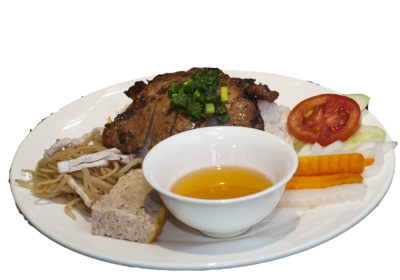

In [ ]:
display(img)

In [ ]:
type(img)

PIL.Image.Image

# Push up all changes

- username: duchaba

- password: [use the token]

In [ ]:
f = '/content/Data-Augmentation-with-Python'
!git -C {f} add -A
!git config --global user.email "duc.haba@gmail.com"
!git config --global user.name "duchaba"
!git -C {f} commit -m "end of session"

In [ ]:
!git -C {f} push

# Summary

Every chaper will begin with same base class "PacktDataAug".

✋ FAIR WARNING:

- The coding uses long and complete function path name.

- I wrote the code for easy to understand and not for compactness, fast execution, nor cleaverness.



In [ ]:
!pip install colab-xterm
%load_ext colabxterm
%xterm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 115 kB 37.2 MB/s 


Launching Xterm...

<IPython.core.display.Javascript object>